In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob
import pandas as pd
from scipy.optimize import curve_fit
from scipy.signal import savgol_filter
from scipy import optimize
import scipy
import scipy.ndimage as ndimage
import scipy.ndimage.filters as filters
from PIL import Image 
import numpy.polynomial.polynomial as poly

%matplotlib inline


In [2]:
cd /Users/austinmcdonald/Desktop/test/cut/Ba/2Spot4/

/Users/austinmcdonald/Desktop/test/cut/Ba/2Spot4


In [4]:
files = os.listdir()
files = files[1:]
#files = files[1:90]
files[1]

'CutImage152_00003.tif'

In [49]:
eCoeff = 0.01160
eOffset= 1917
AVG = 1
Row = 2
Col = 2
Xindex = 112#118
Yindex = 100#55
Row2 = 2
Col2 = 2
Xindex2 = 93
Yindex2 = 74
area = []
areabackground = []
Shape = 221
xvs = np.arange(0,Shape)
IMG=[]
MeanFit = np.zeros(Shape**2).reshape((Shape,Shape))
eCoeffM = eCoeff*np.ones(Shape**2).reshape((Shape,Shape))
eOffsetM = eOffset*np.ones(Shape**2).reshape((Shape,Shape))
for x in range(690,740):
    Images = np.array(Image.open(files[x]))
    Images = eCoeffM*(Images - eOffsetM)
    #Mfit = np.zeros(len(xvs)) # kill this ?
    ImageFit = []
    for y in range(0,Shape):
        coefs = poly.polyfit(xvs,Images[y], 2) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        ImageFit.append(ffit)
    MeanFit+=np.array(ImageFit)
MeanFit = MeanFit/50

for q in range(0,len(files)):
    Images = (np.array(Image.open(files[q])))
    Images = eCoeffM*(Images - eOffsetM) - MeanFit
    Images[Images < 0] = 0
    Ahold = np.array(Images)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
    IMG.append(Ahold)

    ABhold = np.array(Images)[Yindex2-Row2:Yindex2+Row2+1,Xindex2-Col2:Xindex2+Col2+1]
    area.append(Ahold.sum())
    areabackground.append(ABhold.sum())

    HoldArea = np.array(area)
    HoldAreaB = np.array(areabackground)
    aa = np.add.reduceat(HoldArea, np.arange(0, len(HoldArea), AVG))/AVG
    aaB = np.add.reduceat(HoldAreaB, np.arange(0, len(HoldAreaB), AVG))/AVG
    vals =np.arange(0,len(aa))
    coefs = poly.polyfit(vals,aaB, 3)
    ffit  = poly.polyval(vals, coefs)
    Sig = np.array(aa-ffit)
    bac = np.array(aaB-ffit)


//anaconda/envs/py35/lib/python3.5/site-packages/numpy/polynomial/polynomial.py:1383: RankWarning: The fit may be poorly conditioned
  warnings.warn(msg, pu.RankWarning)


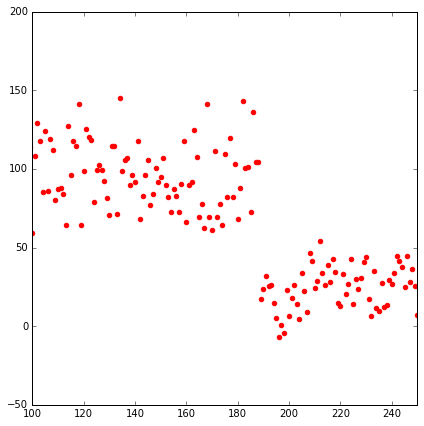

In [46]:
plt.figure(figsize=(6,6))
h=np.arange(0,len(files))
plt.scatter(vals,Sig,color='r')
#plt.plot(h,np.gradient(area))
#plt.scatter(h,areabackground,color='k')
#plt.xlim(60,160)
plt.xlim(100,250)
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/2Step2.pdf')

In [5]:
eCoeff = 0.01160
eOffset= 1917
AVG = 1
Row = 5
Col = 5
Xindex = 112#118
Yindex = 100#55

area = []
areabackground = []
Shape = 221
xvs = np.arange(0,Shape)
IMG=[]
MeanFit = np.zeros(Shape**2).reshape((Shape,Shape))
eCoeffM = eCoeff*np.ones(Shape**2).reshape((Shape,Shape))
eOffsetM = eOffset*np.ones(Shape**2).reshape((Shape,Shape))
for x in range(690,740):
    Images = np.array(Image.open(files[x]))
    Images = eCoeffM*(Images - eOffsetM)
    #Mfit = np.zeros(len(xvs)) # kill this ?
    ImageFit = []
    for y in range(0,Shape):
        coefs = poly.polyfit(xvs,Images[y], 2) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        ImageFit.append(ffit)
    MeanFit+=np.array(ImageFit)
MeanFit = MeanFit/50

for q in range(0,len(files)):
    Images = (np.array(Image.open(files[q])))
    Images = eCoeffM*(Images - eOffsetM) - MeanFit
    Images[Images < 0] = 0
    Ahold = np.array(Images)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1]
    IMG.append(Ahold)


In [6]:
AVG = 1
Row = 5
Col = 5
Xindex = 112#118
Yindex = 100#55

area = []
areabackground = []
Shape = 221
xvs = np.arange(0,Shape)
IMG = dict()
ct = 0
p=0
eCoeff = 0.01160
eOffset= 1917

DataSub=np.zeros(Shape**2).reshape((Shape,Shape))
eCoeffM = eCoeff*np.ones(Shape**2).reshape((Shape,Shape))
eOffsetM = eOffset*np.ones(Shape**2).reshape((Shape,Shape))
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    Images = eCoeffM*(Images - eOffsetM)
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataSub += ImageB 
    ct += 1
    if ct > 2:
        p+=1
        ct = 0
        IMG[p] = (np.array(DataSub)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/2
        DataSub = np.zeros(Shape**2).reshape((Shape,Shape))

In [8]:
len(IMG)

249

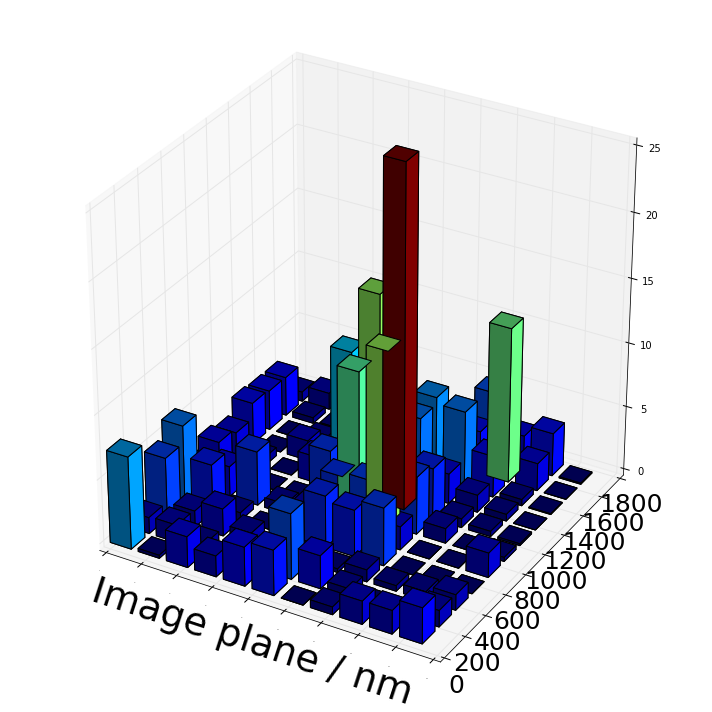

In [14]:
from mpl_toolkits.mplot3d import Axes3D

data = IMG[47]

###########

ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()*160  
ypos = ypos.flatten()*160
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(25))
#colors = plt.cm.jet(data.flatten()/float(dd))

ax.bar3d(xpos,ypos,zpos, 120,120,data.flatten(), color=colors)

#ax.text(1200, 1100, 23, "T = 0s", color='red', fontsize=50)

ax.set_zlim(0, 25)
ax.set_xlabel(r'Image plane / nm', fontsize=38)
#ax.set_zlabel('Intensity (arb. units)', fontsize=38)
plt.xticks(fontsize = 0)
plt.yticks(fontsize = 25)
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/Ba-Postbleach.pdf')
plt.show()

In [8]:
areabackground = np.array(areabackground)
area = np.array(area)
AB = areabackground/1e4
A = area/1e4
h=np.arange(-5,len(A)-5)
ABm = np.mean(AB)


In [9]:
K=4
def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0)) 
    return (cumsum[N:] - cumsum[:-N]) / N 
ma = running_mean(A-ABm,K)
mab = running_mean(AB-ABm,K)
hs = running_mean(h,K)

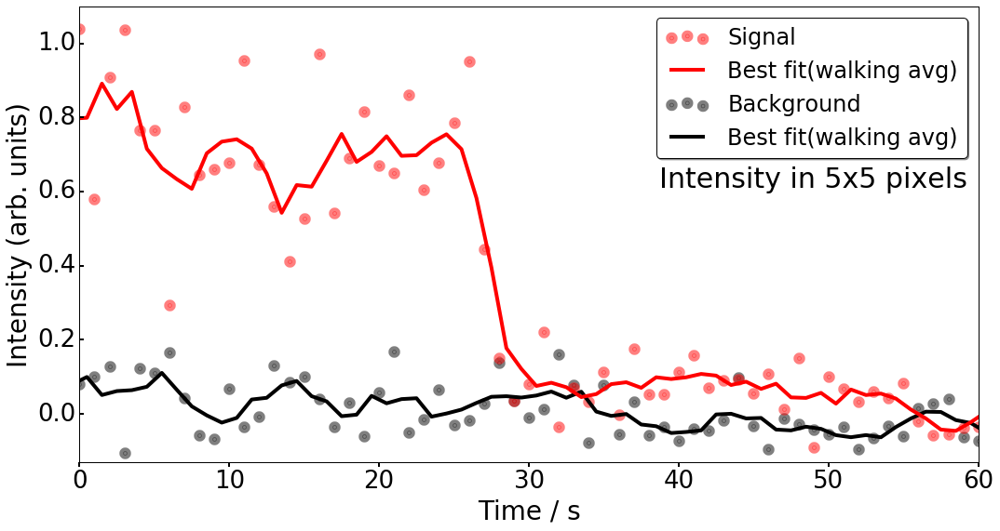

In [10]:
fig, ax = plt.subplots(figsize=(15,8))

#h=np.arange(-40,len(A)-40)
b1 = ax.scatter(h,AB-ABm, color='k',label='Background', alpha=0.5,linewidth=8)
bf1 = ax.plot(hs,mab,color='k',label='Best fit(walking avg)',linewidth=4)

s1 = ax.scatter(h,A-ABm,color='r',label='Signal', alpha=0.5,linewidth=8)
sf1 = ax.plot(hs,ma,color='r',label='Best fit(walking avg)',linewidth=4)

ax.set_xlim(0,60)
ax.set_ylim(-0.13,1.1)

ax.set_xlabel(r'Time / s', fontsize=28)
ax.set_ylabel('Intensity (arb. units)', fontsize=28)

#plt.legend((s1,sf1,b1,bf1),('Signal','Best fit(walking avg)', 'Background','Best fit(walking avg)'),
#           loc='upper right',fontsize=24,shadow=True, fancybox=True)

handles,labels = ax.get_legend_handles_labels()

handles = [handles[3], handles[1], handles[2], handles[0]]
labels = [labels[3], labels[1], labels[2], labels[0]]

ax.legend(handles,labels,fontsize=24,shadow=True, fancybox=True)
plt.xticks(fontsize = 26)
plt.yticks(fontsize = 26)
ax.tick_params(top="off",right='off')
ax.tick_params(axis='x', direction='out',width=2,length=5)
ax.tick_params(axis='y',width=2,length=5)
plt.text(38.7,0.61,r'Intensity in 5x5 pixels',rotation=0,fontsize=30,color='k')
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/Ba-Photobleach.pdf')
plt.show()

In [ ]:
files = os.listdir()
#files = files[1:] # gets rid of ds.store
#files = files[9:] # the first few images in one were funny

In [ ]:
files = files[0:25]

In [ ]:
files

In [ ]:
# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
Xindex = 174 
Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))

for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataS = DataS + ImageB
    
DataF = (np.array(DataS)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)
#DataF = (DataS[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)



    

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

#data = ImageIM-2200
#data = ImageFM-2200
data = DataF

###########

##########
ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()*160  
ypos = ypos.flatten()*160
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
#colors = plt.cm.jet(data.flatten()/float(dd))

ax.bar3d(xpos,ypos,zpos, 120,120,data.flatten(), color=colors)


ax.set_zlim(0, 1300)
ax.set_xlabel(r'Image plane / nm', fontsize=22)
ax.set_zlabel('Intensity (arb. units)', fontsize=22)
plt.xticks(fontsize = 13)
plt.yticks(fontsize = 13)
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/Ba-Postbleach.pdf')
plt.show()

In [ ]:
dd = data.max()
dd

In [ ]:
xpos

In [ ]:
#files

In [12]:
# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
Xindex = 174 
Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))
IMG = dict()
ct = 0
p=0
DataSub = np.zeros(Shape**2).reshape((Shape,Shape))
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataSub += ImageB 
    ct += 1
    if ct > 2:
        p+=1
        ct = 0
        IMG[p] = (np.array(DataSub)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/2
        DataSub = np.zeros(Shape**2).reshape((Shape,Shape))
    
#DataF = (np.array(ImageB)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)
#DataF = (DataS[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)



    

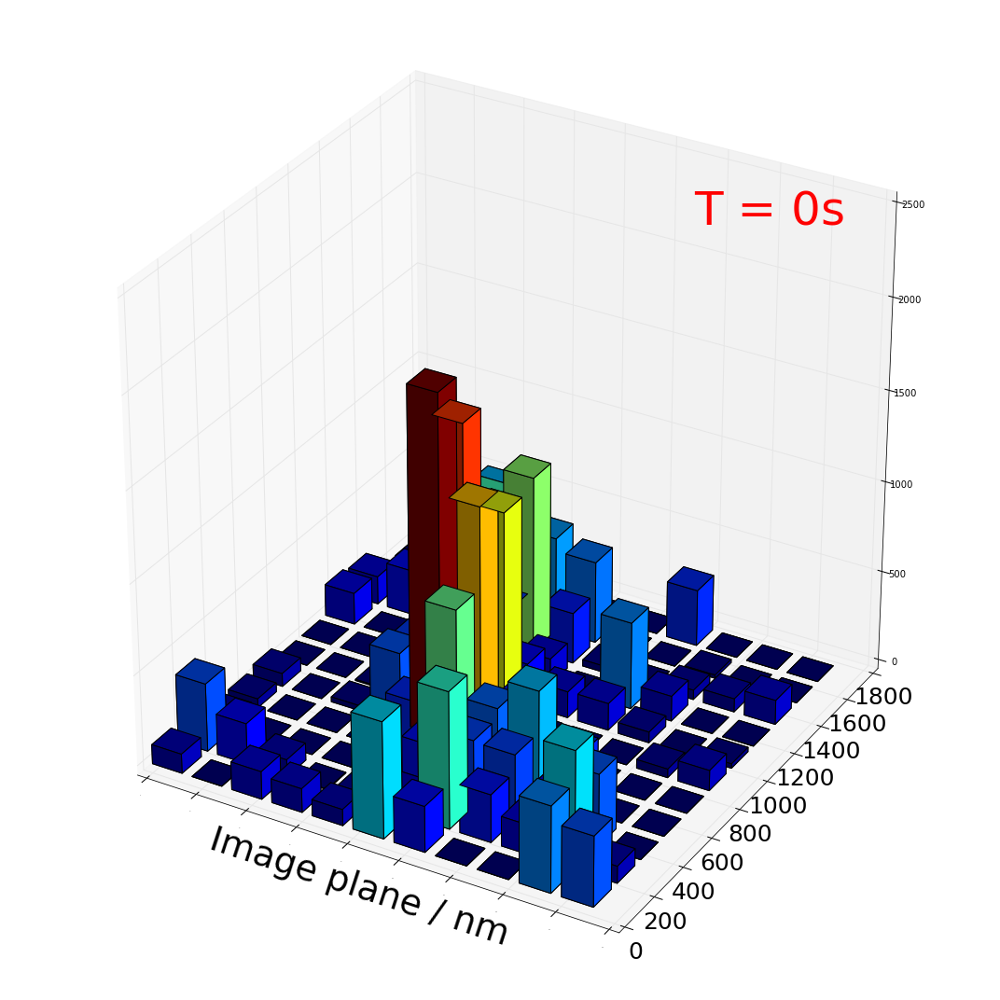

In [20]:
from mpl_toolkits.mplot3d import Axes3D

#data = ImageIM-2200
#data = ImageFM-2200
data = IMG[1]

###########

##########
ypos, xpos  = np.indices(data.shape) 

xpos = xpos.flatten()*160  
ypos = ypos.flatten()*160
zpos = np.zeros(xpos.shape)

fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d')

colors = plt.cm.jet(data.flatten()/float(data.max()))
#colors = plt.cm.jet(data.flatten()/float(dd))

ax.bar3d(xpos,ypos,zpos, 120,120,data.flatten(), color=colors)

ax.text(1200, 1600, 2300, "T = 0s", color='red', fontsize=50)

ax.set_zlim(0, 2500)
ax.set_xlabel(r'Image plane / nm', fontsize=38)
#ax.set_zlabel('Intensity (arb. units)', fontsize=38)
plt.xticks(fontsize = 0)
plt.yticks(fontsize = 25)
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/Ba-Postbleach.pdf')
plt.show()

In [14]:
bb = []
for a in range(1,len(IMG)):
    aa = IMG[a].max()
    bb.append(aa)
max(bb)

2487.5739327962697

In [ ]:
/Users/austinmcdonald/Desktop/First\ Ba/BaHistTime

//anaconda/envs/py35/lib/python3.5/site-packages/matplotlib/pyplot.py:516: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


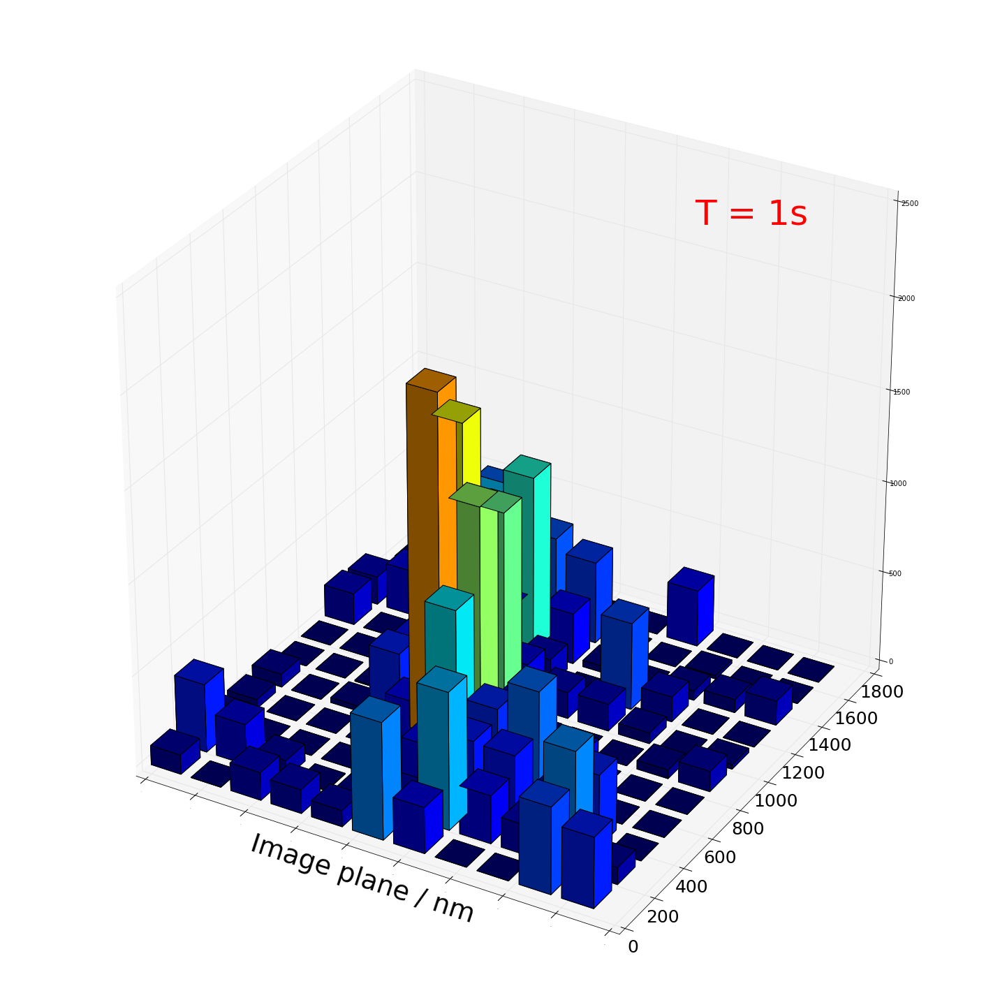

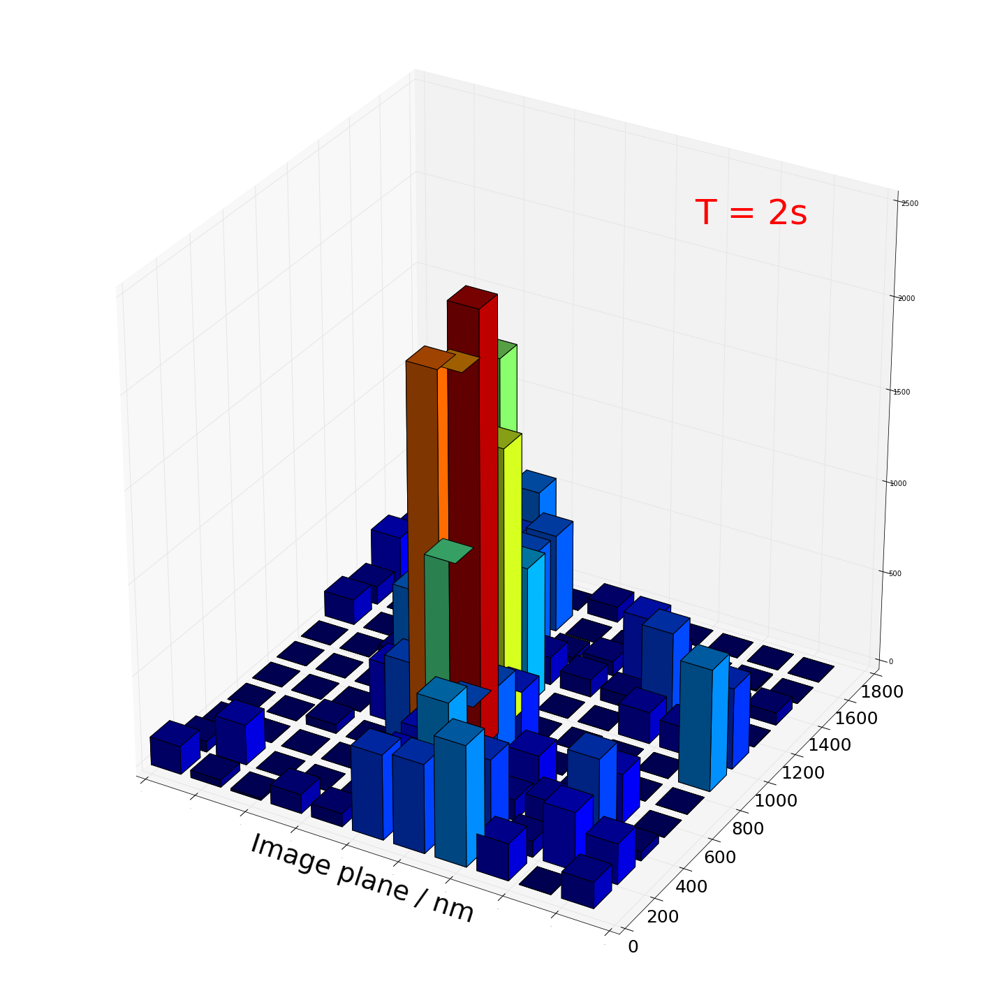

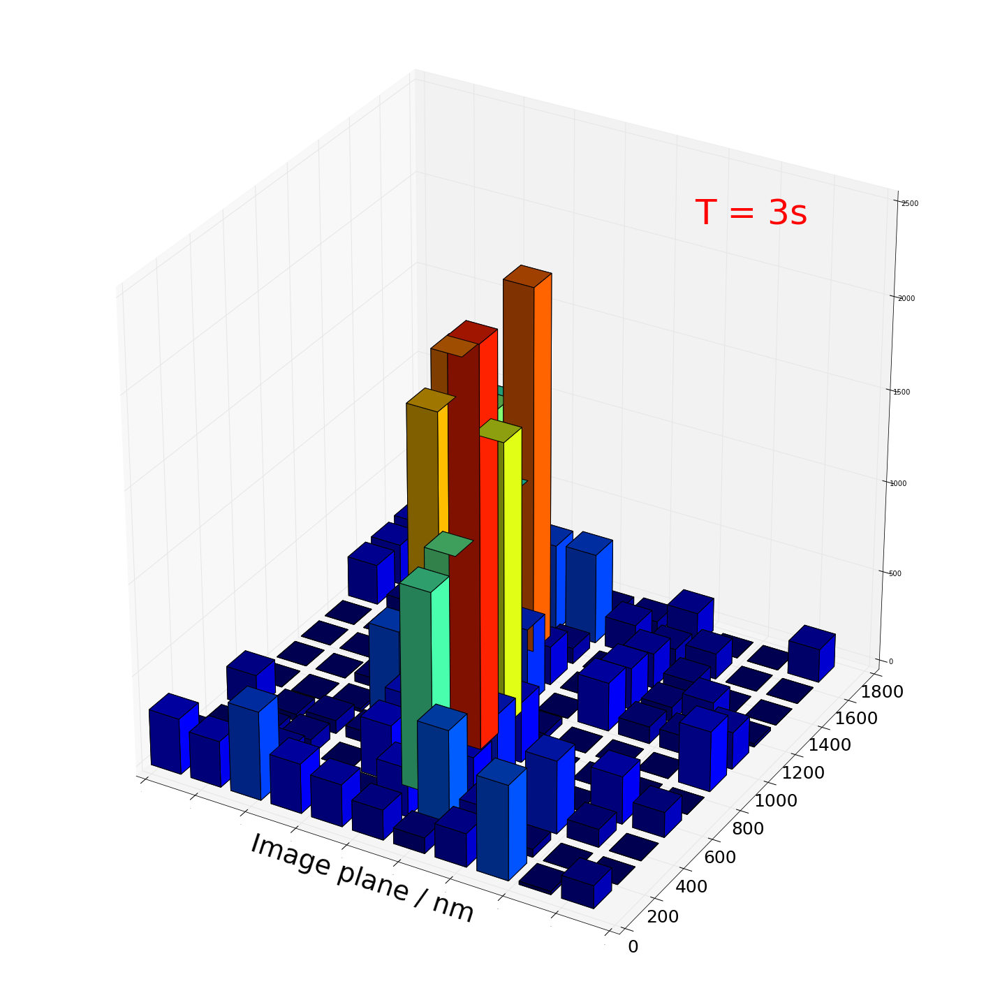

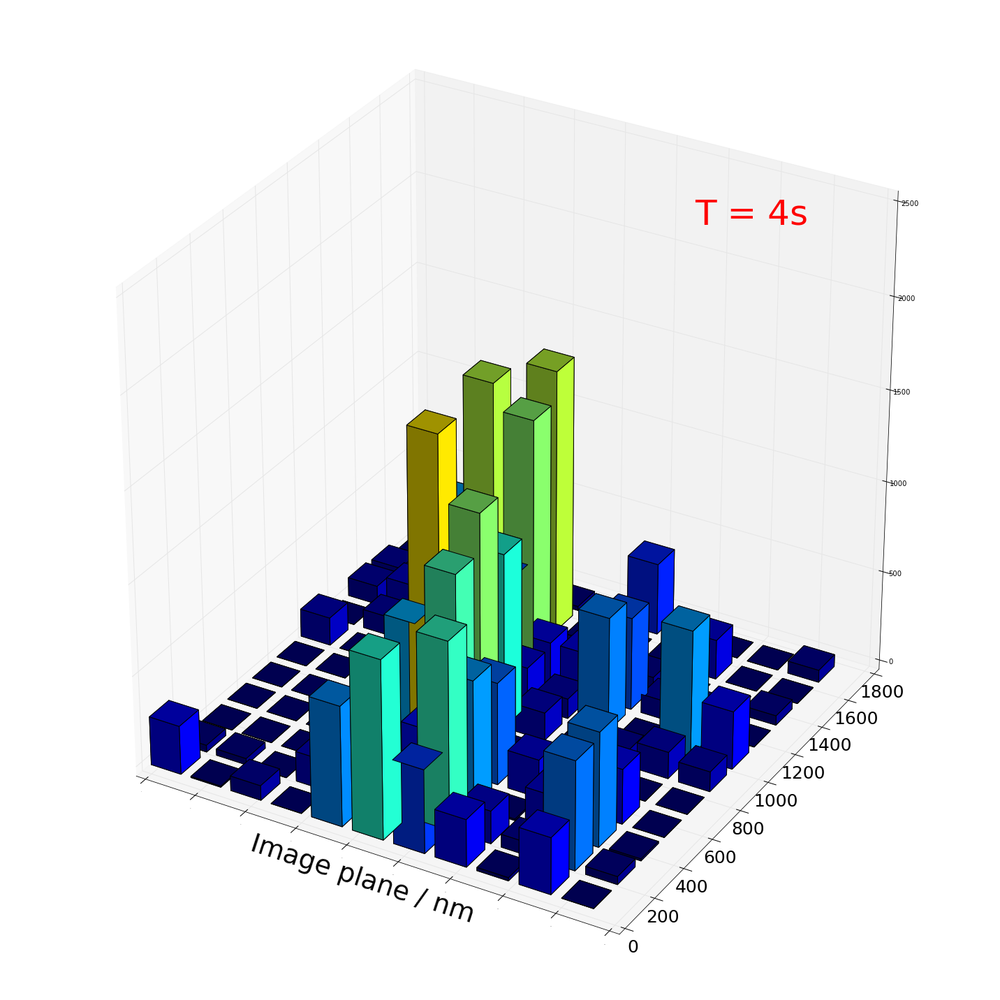

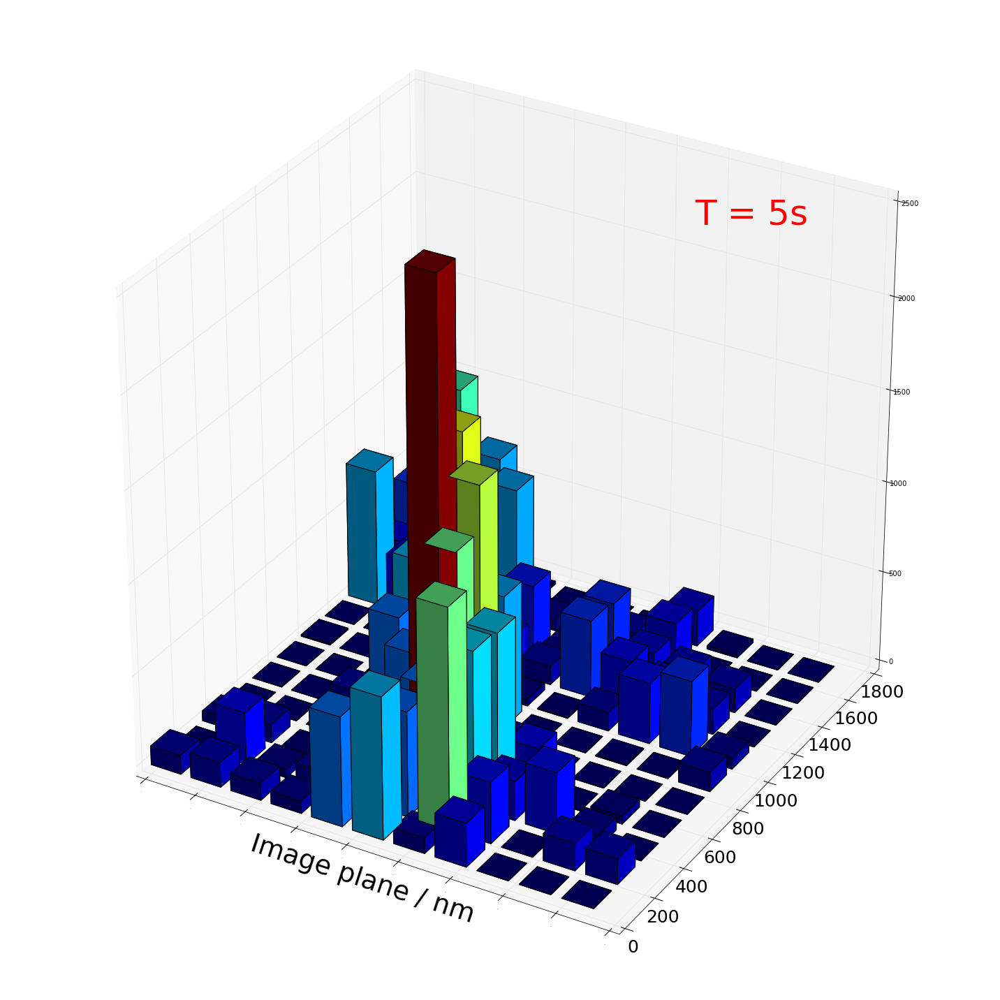

...

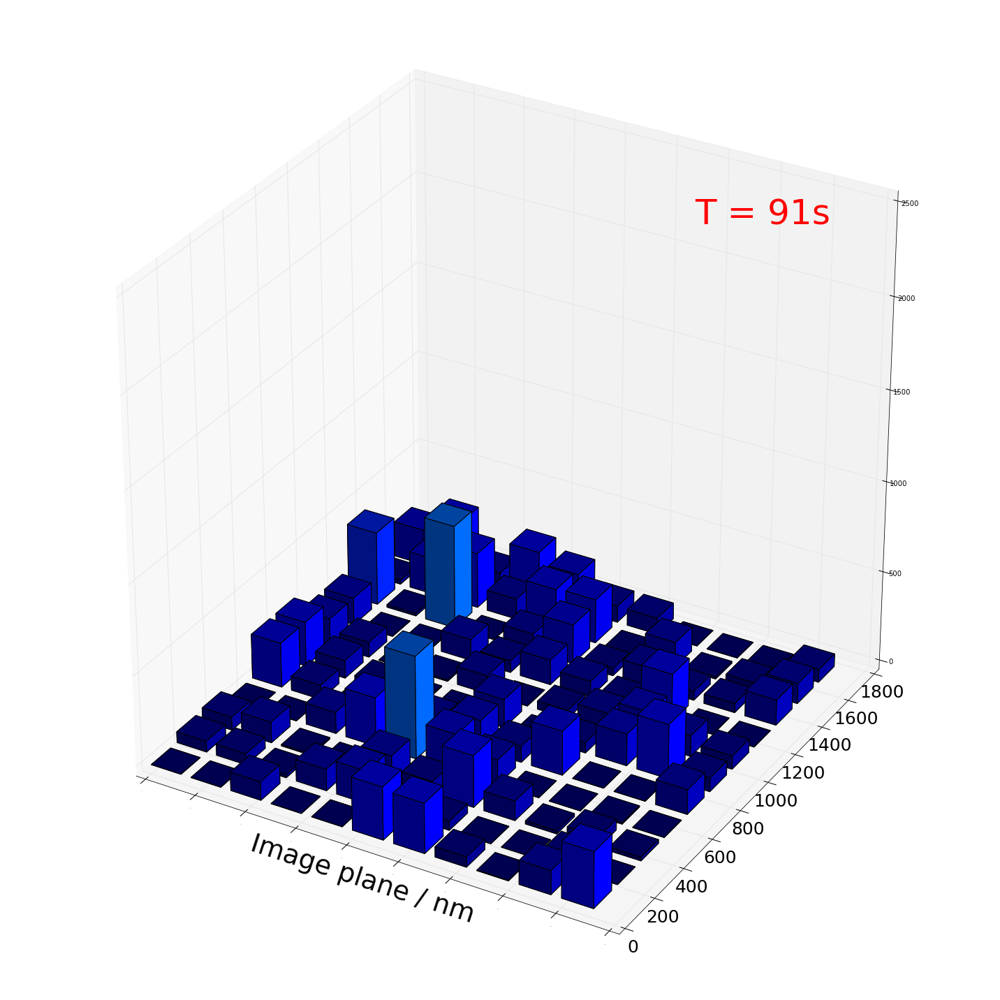

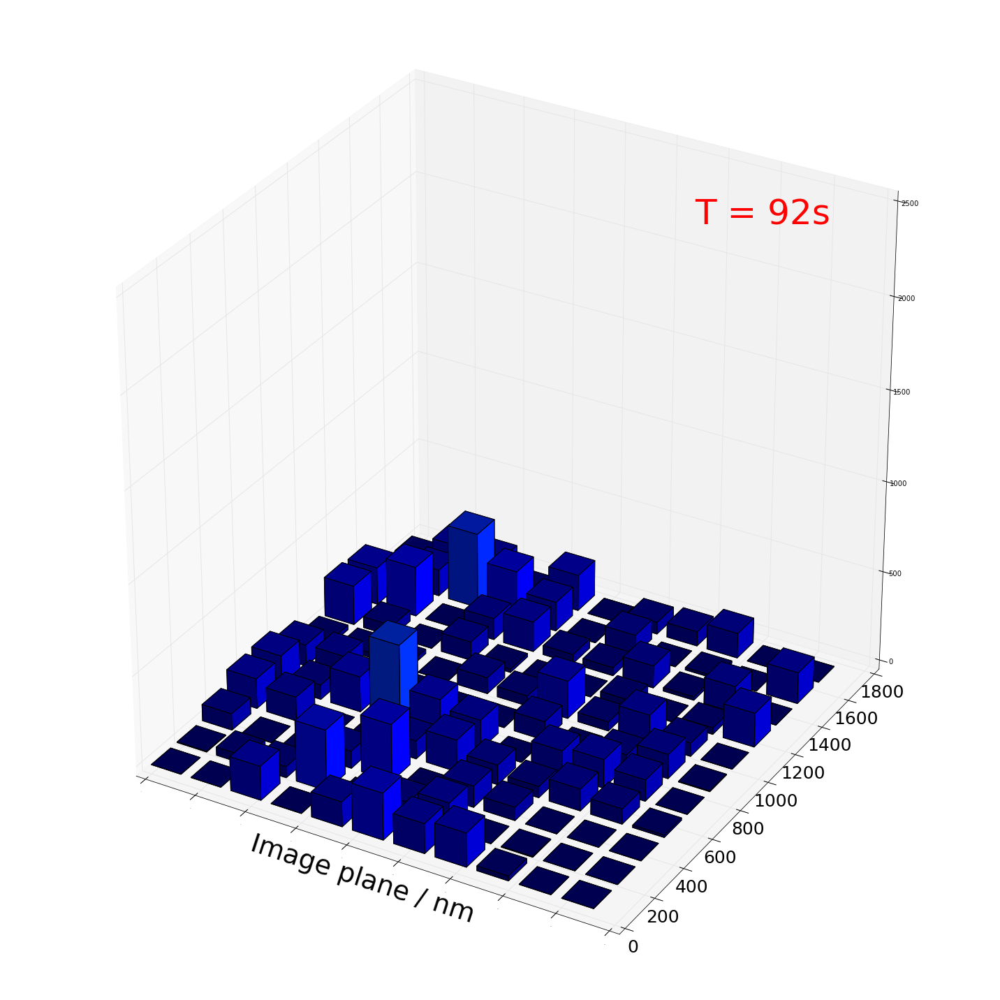

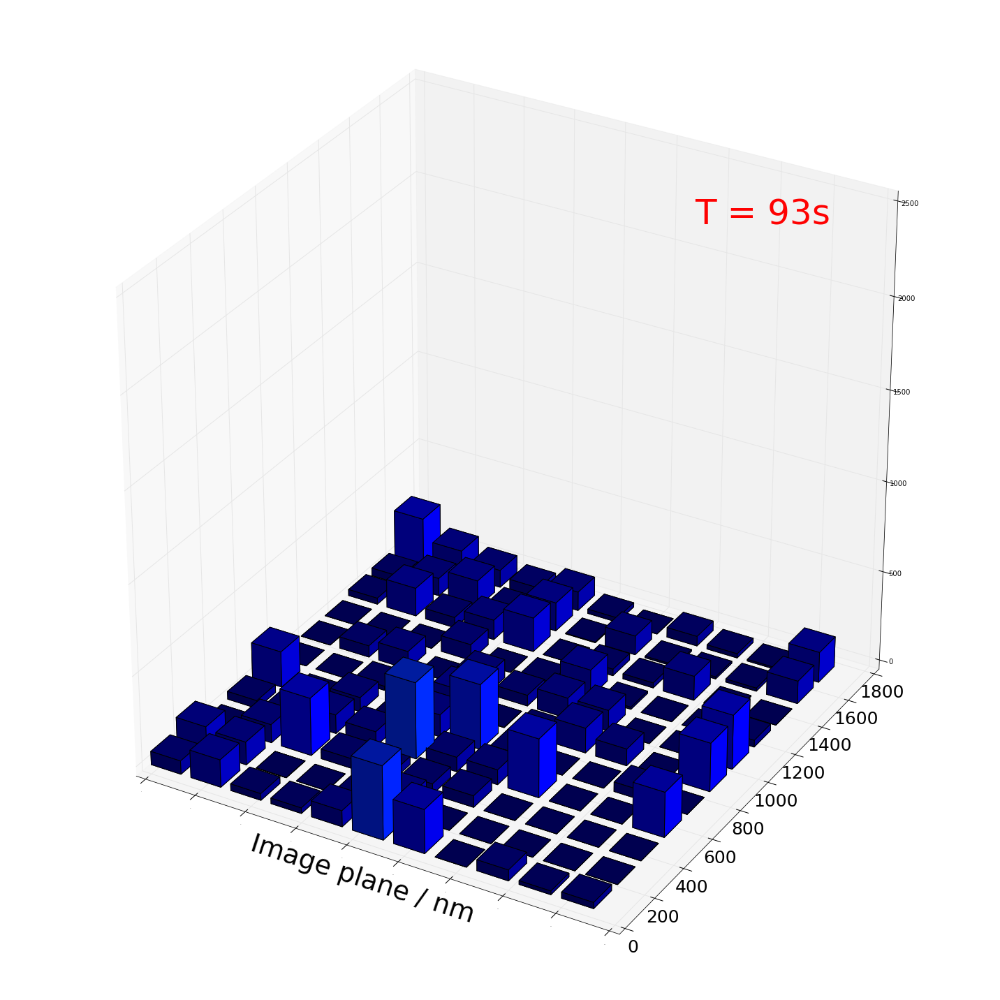

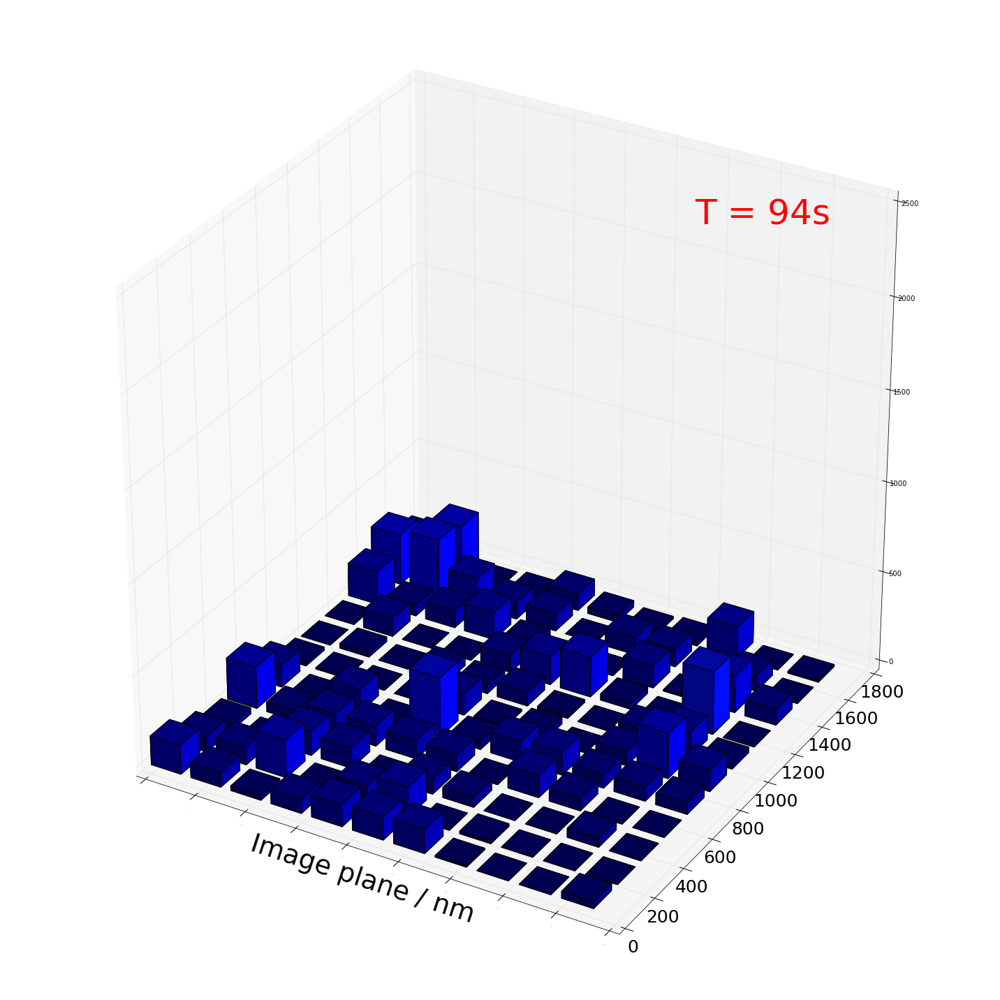

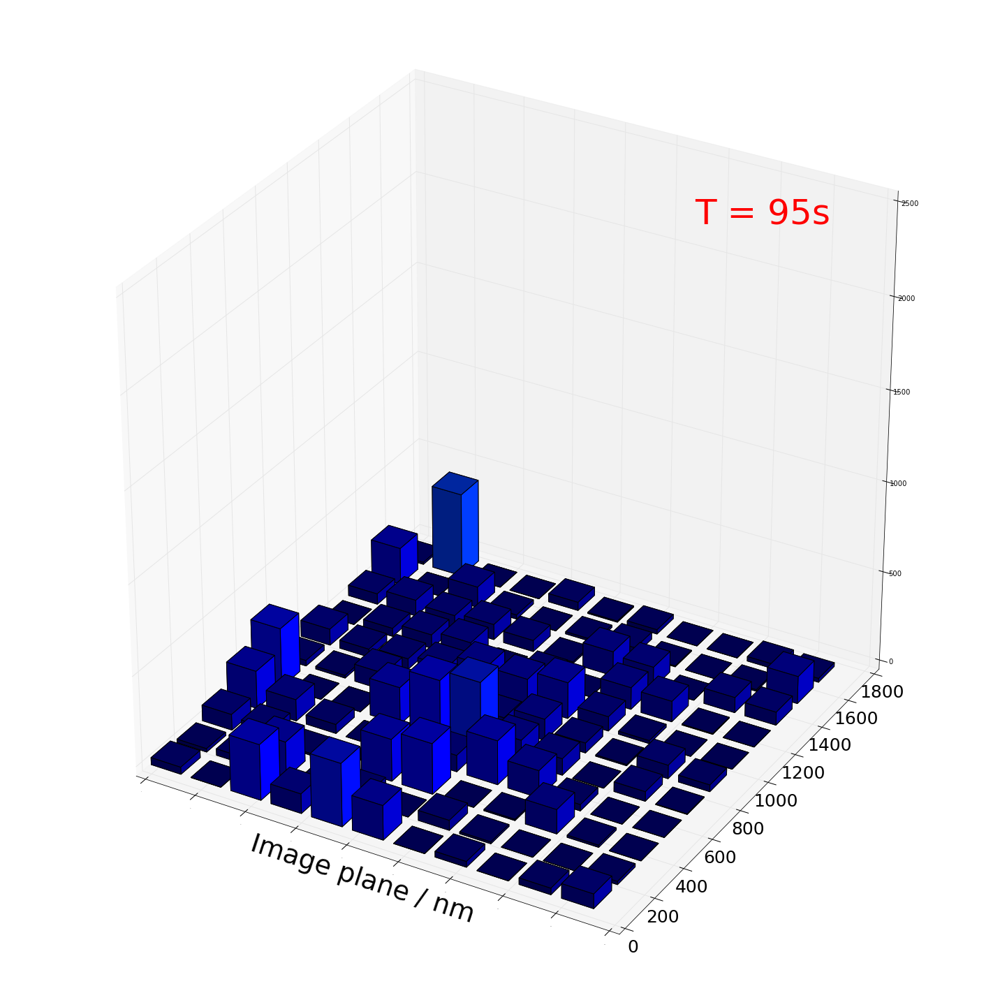

In [24]:
for x in range(1,len(IMG)):
    data = IMG[x]
    ypos, xpos  = np.indices(data.shape) 

    xpos = xpos.flatten()*160  
    ypos = ypos.flatten()*160
    zpos = np.zeros(xpos.shape)

    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111, projection='3d')

    colors = plt.cm.jet(data.flatten()/float(2500))
    ax.bar3d(xpos,ypos,zpos, 120,120,data.flatten(), color=colors)
    ax.text(1200, 1600, 2300, "T = " + str(x) + 's', color='red', fontsize=50)
    ax.set_zlim(0, 2500)
    ax.set_xlabel(r'Image plane / nm', fontsize=38)
    #ax.set_zlabel('Intensity (arb. units)', fontsize=22)
    plt.xticks(fontsize = 0)
    plt.yticks(fontsize = 25)
    plt.tight_layout()
    plt.savefig('/Users/austinmcdonald/Desktop/FirstBa/BaHistTime/test'+str(x)+'.png')
#plt.show()



In [9]:

# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
Xindex = 174 
Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))
IMG = dict()
ct = 0
p=0
DataSub = np.zeros(Shape**2).reshape((Shape,Shape))
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataSub += ImageB 
    ct += 1
    if ct > 2:
        p+=1
        ct = 0
        spot = (np.array(DataSub)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/2
        im = Image.fromarray(spot.astype('float64'))
        im.save('/Users/austinmcdonald/Desktop/BaTiff/' + str(p) + files[q])
        DataSub = np.zeros(Shape**2).reshape((Shape,Shape))

        


In [ ]:
im.show()

In [ ]:

# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
Xindex = 174 
Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))
AA = dict()
ct = 0
p=0
DataSub = np.zeros(Shape**2).reshape((Shape,Shape))
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataSub += ImageB 
    ct += 1
    if ct > 2:
        p+=1
        ct = 0
        AA[p] = (np.array(DataSub)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/2
        #im = Image.fromarray(spot.astype('float64'))
        #im.save('/Users/austinmcdonald/Desktop/BaTiff/' + str(p) + files[q])
        DataSub = np.zeros(Shape**2).reshape((Shape,Shape))

        


In [ ]:
for x in range(1,len(AA)):
    plt.figure(figsize=(7,7))
    colors = plt.cm.jet(AA[x]/float(2500))
    plt.imshow(AA[x], cmap='jet', interpolation='nearest')

#plt.scatter(x,y, color = 'lime',linewidth=4)

#plt.imshow(Imdat)
    plt.xlim(0,10)
    plt.ylim(0,10)
#plt.plot([14,14+6.25],[179,179],linewidth=3,color='white')
#plt.plot([14,14],[177,181],linewidth=2,color='white')
#plt.plot([14+6.5,14+6.5],[177,181],linewidth=2,color='white')
    plt.text(6,9,"T = " + str(x) + 's',rotation=0,fontsize=40,color='white')
    plt.tick_params(labelbottom='off',labelleft='off')
    plt.tight_layout()
    plt.savefig('/Users/austinmcdonald/Desktop/BaTiff/' + str(x) + files[x])


    plt.show()

In [ ]:
colors

In [ ]:
# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
#Xindex = 174 
#Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))
datdat  = dict()
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    datdat[q] =  ImageB
    
#DataF = (np.array(DataS)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)
#DataF = (DataS[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/len(files)




In [ ]:

# 2 = 390->405
# 1 = 410->425
# 0 = 430->445
Xindex = 174 
Yindex = 84
Shape = 201
Row = int(5) # define the area to take around the spots
Col = int(5) # define the area to take around the spots
xvs = np.arange(0,Shape)
DataS=np.zeros(Shape**2).reshape((Shape,Shape))
IMG = dict()
ct = 0
p=0
DataSub = np.zeros(Shape**2).reshape((Shape,Shape))
for q in range(0,len(files)):
    Images = np.array(Image.open(files[q]))
    ImageB = []
    for x in range(0,Shape):
        coefs = poly.polyfit(xvs, Images[x], 11) # fits 11th order poly 
        ffit  = poly.polyval(xvs, coefs)
        hold  = Images[x]-(ffit)
        hold[hold < 0] = 0        # replaces negtive values form the sub with 0
        ImageB.append(hold)
    DataSub += ImageB 
    ct += 1
    if ct > 10:
        p+=1
        ct = 0
        datdat[p] = DataSub
        #spot = (np.array(DataSub)[Yindex-Row:Yindex+Row+1,Xindex-Col:Xindex+Col+1])/2
        #im = Image.fromarray(spot.astype('float64'))
        #im.save('/Users/austinmcdonald/Desktop/BaTiff/' + str(p) + files[q])
        DataSub = np.zeros(Shape**2).reshape((Shape,Shape))

        


In [ ]:
plt.figure(figsize=(7,7))
plt.imshow(datdat[1]/10, cmap='afmhot', interpolation='nearest')

plt.scatter(x,y, color = 'lime',linewidth=4)

#plt.imshow(Imdat)
plt.xlim(0,200)
plt.ylim(0,200)
plt.plot([14,14+6.25],[179,179],linewidth=3,color='white')
plt.plot([14,14],[177,181],linewidth=2,color='white')
plt.plot([14+6.5,14+6.5],[177,181],linewidth=2,color='white')
plt.text(25,175,r'1 $\mu$m',rotation=0,fontsize=30,color='white')
plt.tick_params(labelbottom='off',labelleft='off')
plt.tight_layout()
#plt.savefig('/Users/austinmcdonald/Desktop/BaFirstss.pdf')

plt.show()

In [ ]:

#fname = 'RImHW.png'
neighborhood_size = 5
threshold = 6500


data = np.array(datdat[1])
 #scipy.misc.imread(fname)

data_max = filters.maximum_filter(data, neighborhood_size)
maxima = (data == data_max)
data_min = filters.minimum_filter(data, neighborhood_size)
diff = ((data_max - data_min) > threshold)
maxima[diff == 0] = 0

labeled, num_objects = ndimage.label(maxima)
slices = ndimage.find_objects(labeled)
x, y = [], []
for dy,dx in slices:
    x_center = (dx.start + dx.stop - 1)/2
    x.append(x_center)
    y_center = (dy.start + dy.stop - 1)/2    
    y.append(y_center)
plt.imshow(data)
#plt.xlim(300,500)
#plt.ylim(100,300)
plt.show()
plt.imshow(data)
#plt.savefig('/tmp/data.png', bbox_inches = 'tight')

plt.autoscale(False)
plt.plot(x,y, 'ro')
#plt.xlim(300,500)
#plt.ylim(100,300)
plt.show()
Xc = x
Yc = y
#plt.savefig('/tmp/result.png', bbox_inches = 'tight')
